In [1]:
%mkdir /kaggle/working/Utilities
%cp -r /kaggle/input/utilities/*.py /kaggle/working/Utilities

In [2]:
!pip install torchsummary
!pip install torchmetrics
!pip install torch_lr_finder
!pip install pytorch_lightning

In [3]:
%load_ext autoreload
%autoreload 2

In [4]:
import pytorch_lightning as pl
from pytorch_lightning.callbacks import LearningRateMonitor, ModelCheckpoint
from pytorch_lightning.tuner import Tuner
from torchsummary import summary
from Utilities import config
from Utilities.callbacks import (
    CheckClassAccuracyCallback,
    MAPCallback,
    PlotTestExamplesCallback,
)
from Utilities.model import YOLOv3

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [5]:
model = YOLOv3(num_classes=config.NUM_CLASSES)
summary(model.to(config.DEVICE), input_size=(3, config.IMAGE_SIZE, config.IMAGE_SIZE))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 416, 416]             864
       BatchNorm2d-2         [-1, 32, 416, 416]              64
         LeakyReLU-3         [-1, 32, 416, 416]               0
          CNNBlock-4         [-1, 32, 416, 416]               0
            Conv2d-5         [-1, 64, 208, 208]          18,432
       BatchNorm2d-6         [-1, 64, 208, 208]             128
         LeakyReLU-7         [-1, 64, 208, 208]               0
          CNNBlock-8         [-1, 64, 208, 208]               0
            Conv2d-9         [-1, 32, 208, 208]           2,048
      BatchNorm2d-10         [-1, 32, 208, 208]              64
        LeakyReLU-11         [-1, 32, 208, 208]               0
         CNNBlock-12         [-1, 32, 208, 208]               0
           Conv2d-13         [-1, 64, 208, 208]          18,432
      BatchNorm2d-14         [-1, 64, 2

In [6]:
from Utilities.dataset import YOLODataModule

data_module = YOLODataModule(
    train_csv_path=config.DATASET + "/train.csv",
    test_csv_path=config.DATASET + "/test.csv"
)

In [7]:
import pytorch_lightning as pl
from pytorch_lightning.callbacks import ModelCheckpoint, LearningRateMonitor
from Utilities.callbacks import PlotTestExamplesCallback, MAPCallback, CheckClassAccuracyCallback

trainer = pl.Trainer(
    max_epochs=40,
    accelerator=config.DEVICE,
    callbacks=[
        ModelCheckpoint(
            dirpath=config.CHECKPOINT_PATH,
            verbose=True
        ),
        PlotTestExamplesCallback(every_n_epochs=5),
        CheckClassAccuracyCallback(train_every_n_epochs=8, test_every_n_epochs=4),
        MAPCallback(every_n_epochs=40),
        LearningRateMonitor(logging_interval='step', log_momentum=True)
    ],
    default_root_dir='Store/',
    precision='16-mixed'
)

In [8]:
# %rm -rf /kaggle/working/Store/lightning_logs

In [9]:
# %mkdir /kaggle/working/Store
# %mkdir /kaggle/working/Store/checkpoints

In [10]:
%ls /kaggle/working/Store

ls: cannot access '/kaggle/working/Store': No such file or directory


In [11]:
import os

directory = "/kaggle/working/Store/checkpoints"
if not os.path.exists(directory):
    os.makedirs(directory)

In [12]:
from pytorch_lightning.tuner import Tuner

tuner = Tuner(trainer=trainer)

# Run LR finder
lr_finder = tuner.lr_find(model, datamodule=data_module, min_lr=1e-4, max_lr=1, num_training=trainer.max_epochs)

/opt/conda/lib/python3.10/site-packages/pytorch_lightning/trainer/configuration_validator.py:69: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")


Finding best initial lr:   0%|          | 0/40 [00:00<?, ?it/s]

Epoch: 0, Loss: nan


suggested_lr=0.0031622776601683794


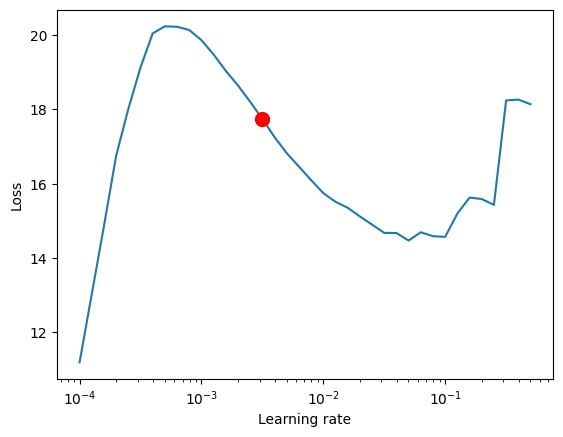

In [13]:
# Plot with
fig = lr_finder.plot(suggest=True)
fig.show()

# Pick point based on plot, or get suggestion
suggested_lr = lr_finder.suggestion()
print(f"{suggested_lr=}")

In [14]:
model.best_lr = 0.0031622776601683794

/opt/conda/lib/python3.10/site-packages/pytorch_lightning/trainer/configuration_validator.py:69: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
/opt/conda/lib/python3.10/site-packages/pytorch_lightning/callbacks/model_checkpoint.py:617: UserWarning: Checkpoint directory /kaggle/working/Store/checkpoints exists and is not empty.
  rank_zero_warn(f"Checkpoint directory {dirpath} exists and is not empty.")


Training: 0it [00:00, ?it/s]

Epoch: 0, Loss: 10.928609848022461
Epoch: 1, Loss: 8.026472091674805
Epoch: 2, Loss: 7.41795015335083
+++ TEST ACCURACIES



100%|██████████| 124/124 [01:32<00:00,  1.35it/s]


Class accuracy is: 41.016903%
No obj accuracy is: 97.683266%
Obj accuracy is: 31.571072%
Epoch: 3, Loss: 6.867676734924316


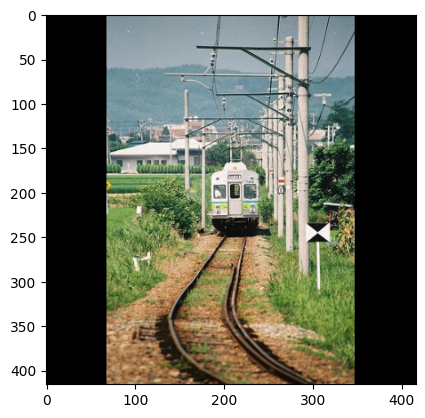

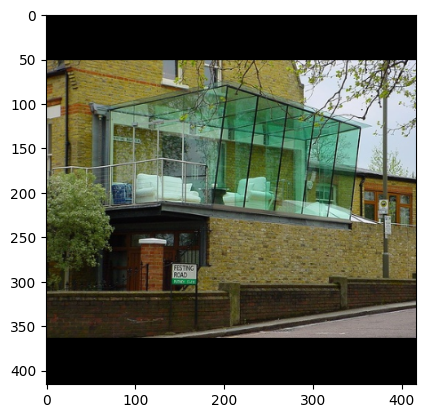

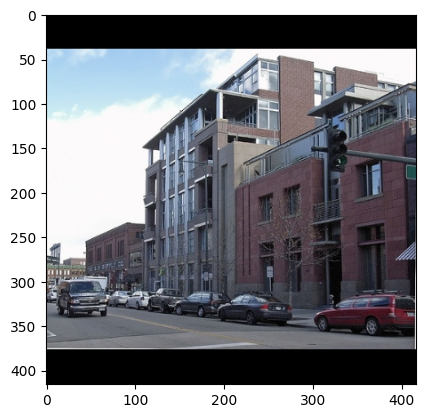

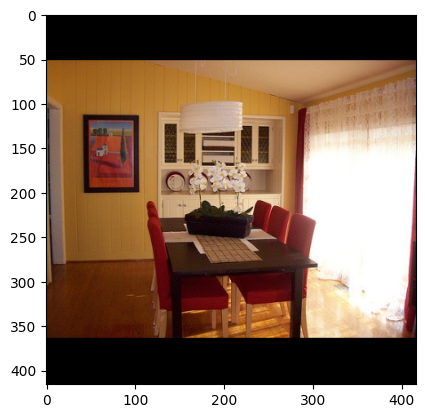

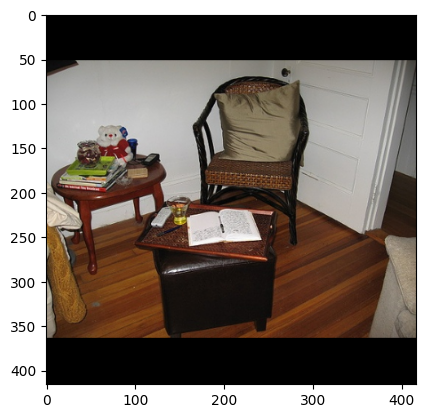

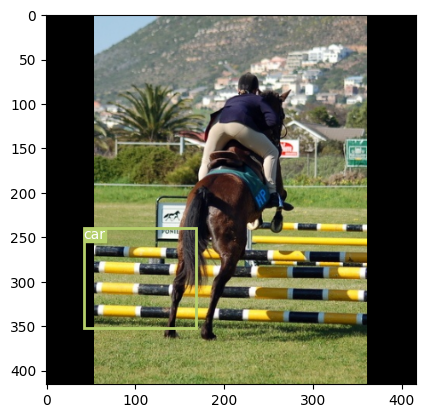

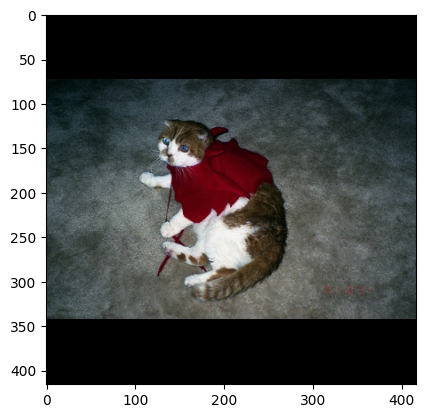

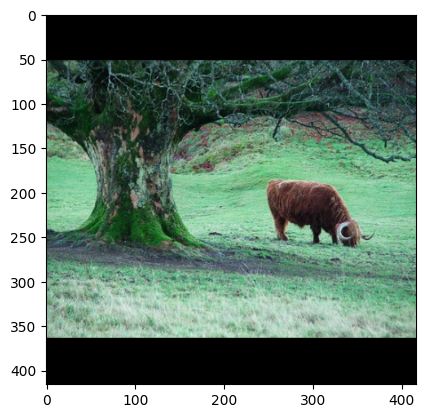

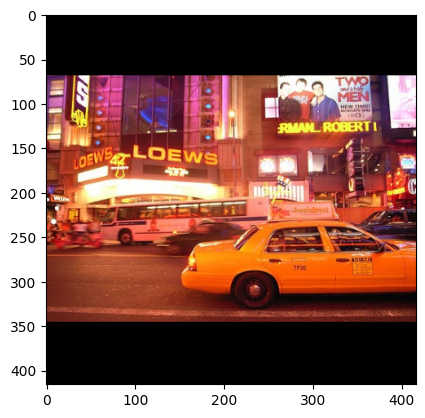

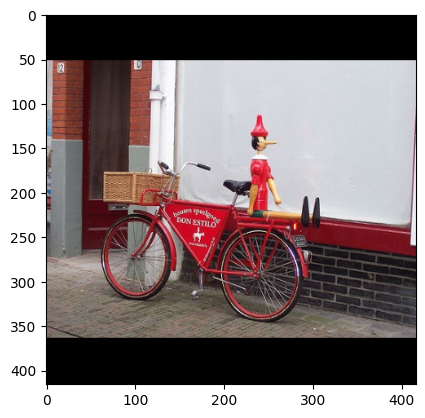

Epoch: 4, Loss: 6.553554534912109
Epoch: 5, Loss: 6.341279029846191
Epoch: 6, Loss: 6.1299309730529785
+++ TRAIN ACCURACIES



100%|██████████| 414/414 [07:52<00:00,  1.14s/it]


Class accuracy is: 44.801571%
No obj accuracy is: 96.033981%
Obj accuracy is: 50.657391%
+++ TEST ACCURACIES



100%|██████████| 124/124 [01:03<00:00,  1.95it/s]


Class accuracy is: 53.837627%
No obj accuracy is: 96.736259%
Obj accuracy is: 47.531174%
Epoch: 7, Loss: 5.986669540405273
Epoch: 8, Loss: 5.882408142089844


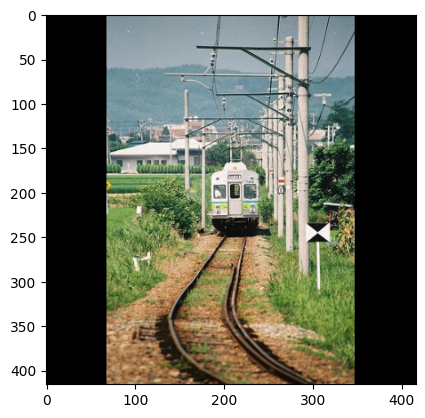

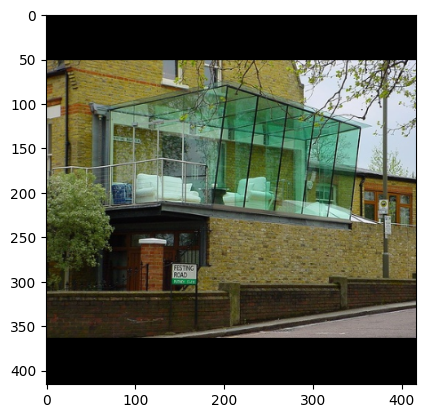

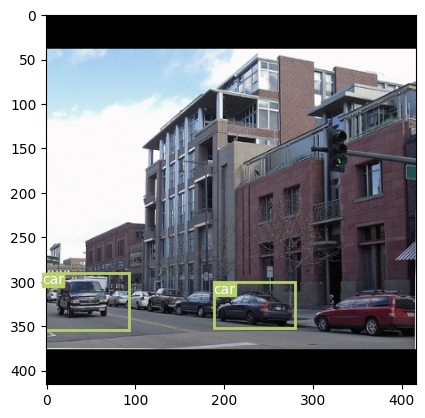

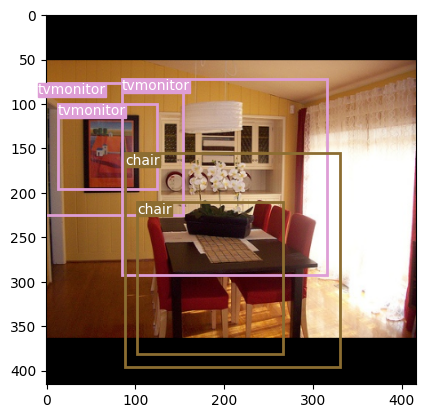

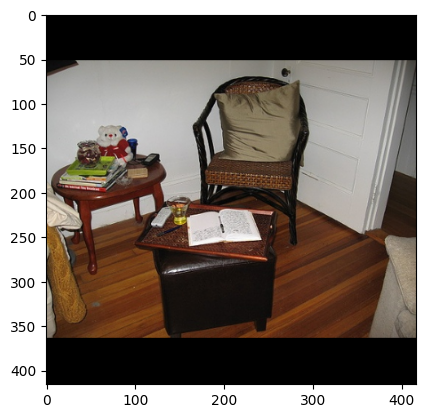

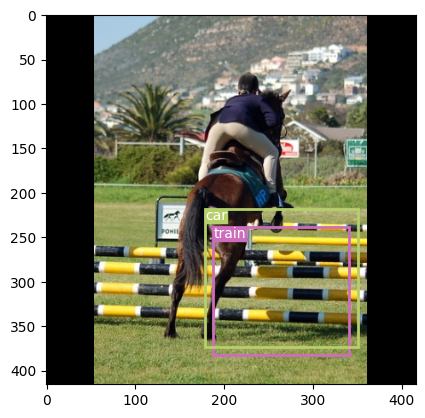

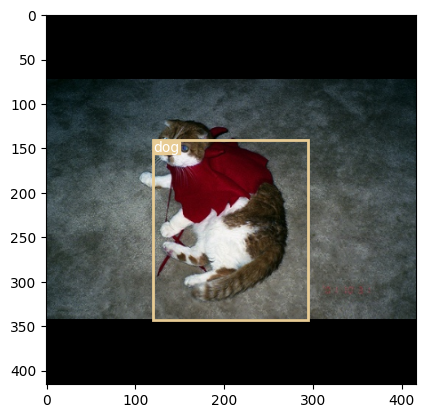

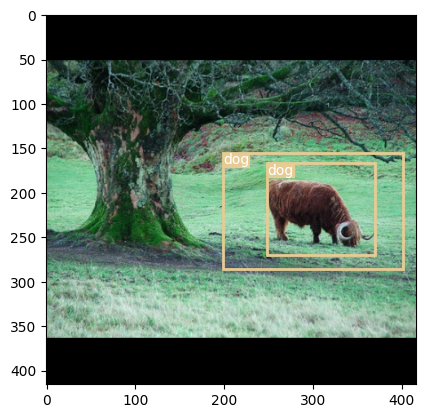

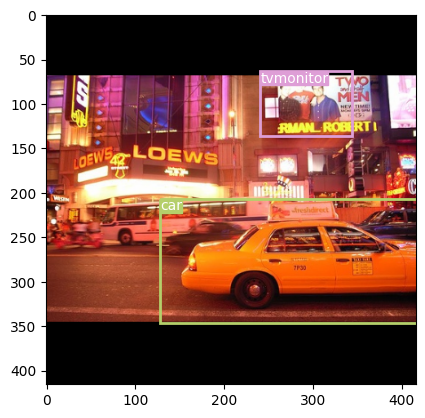

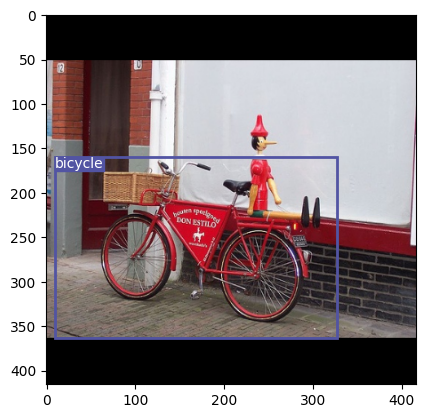

Epoch: 9, Loss: 5.698788166046143
Epoch: 10, Loss: 5.607735633850098
+++ TEST ACCURACIES



100%|██████████| 124/124 [01:03<00:00,  1.97it/s]


Class accuracy is: 61.482407%
No obj accuracy is: 95.958916%
Obj accuracy is: 58.210033%
Epoch: 11, Loss: 5.4896039962768555
Epoch: 12, Loss: 5.371456146240234
Epoch: 13, Loss: 5.247055530548096


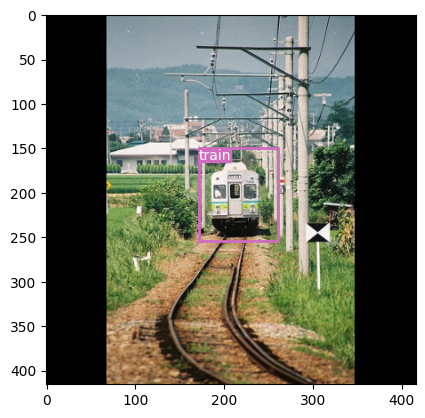

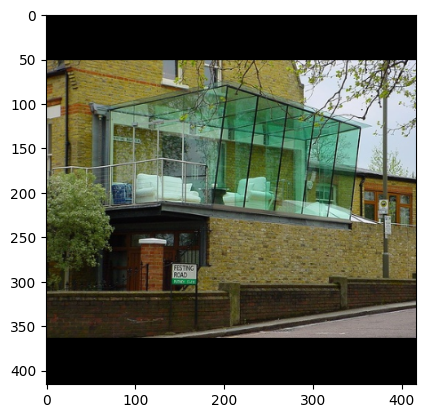

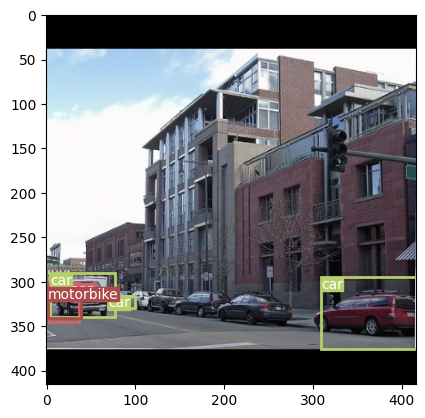

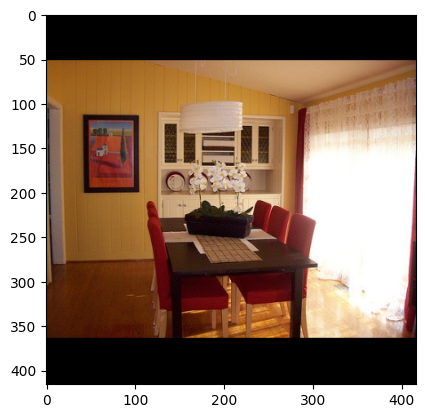

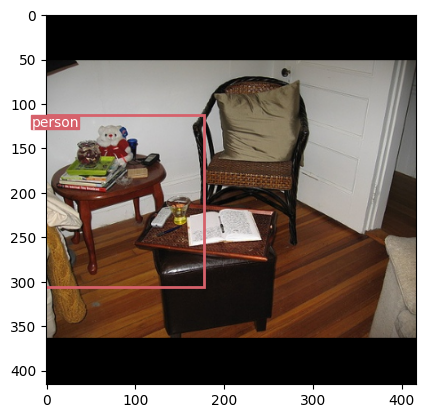

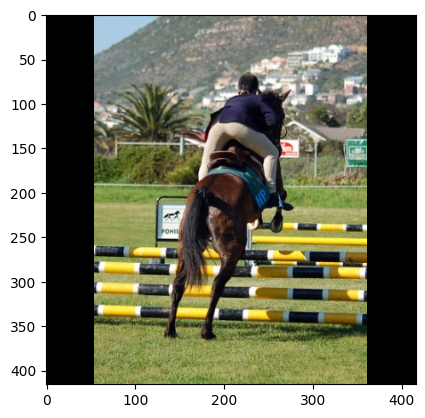

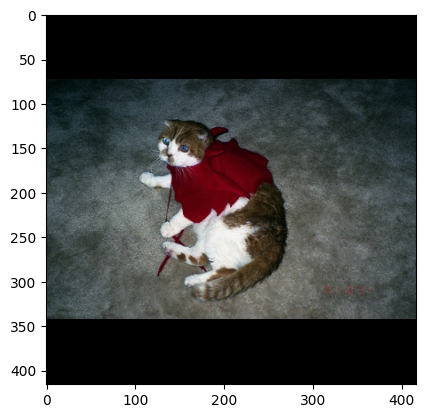

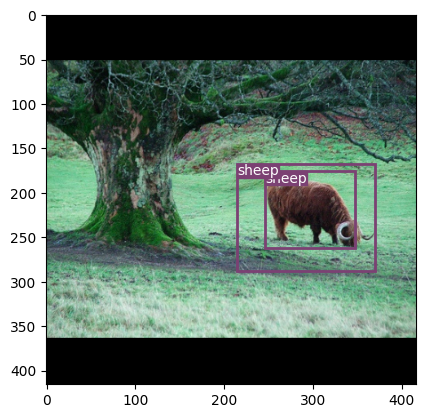

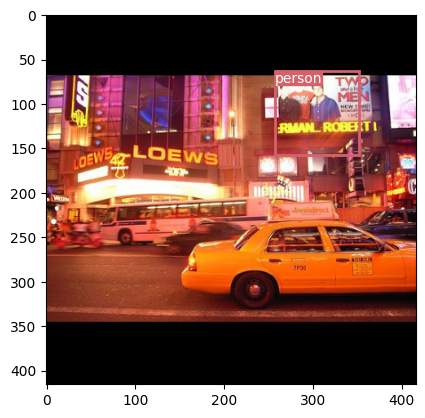

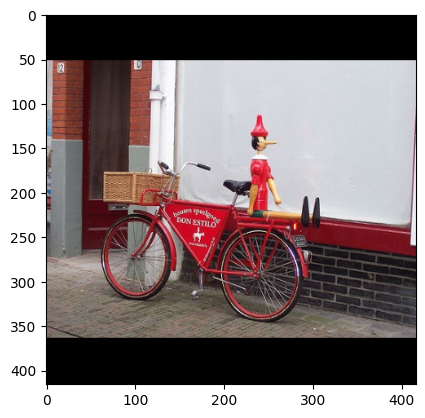

Epoch: 14, Loss: 5.145310878753662
+++ TRAIN ACCURACIES



100%|██████████| 414/414 [07:46<00:00,  1.13s/it]


Class accuracy is: 58.730984%
No obj accuracy is: 96.177765%
Obj accuracy is: 64.808258%
+++ TEST ACCURACIES



100%|██████████| 124/124 [01:02<00:00,  1.99it/s]


Class accuracy is: 68.295929%
No obj accuracy is: 97.073303%
Obj accuracy is: 59.390415%
Epoch: 15, Loss: 5.004179000854492
Epoch: 16, Loss: 4.854735851287842
Epoch: 17, Loss: 4.776919364929199
Epoch: 18, Loss: 4.684315204620361


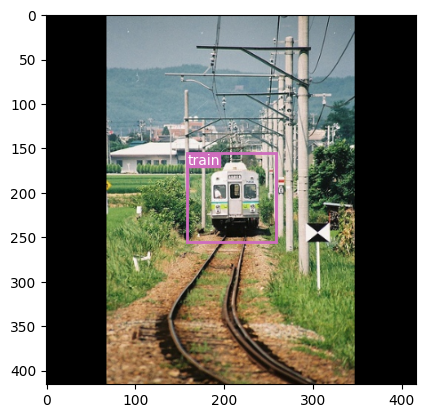

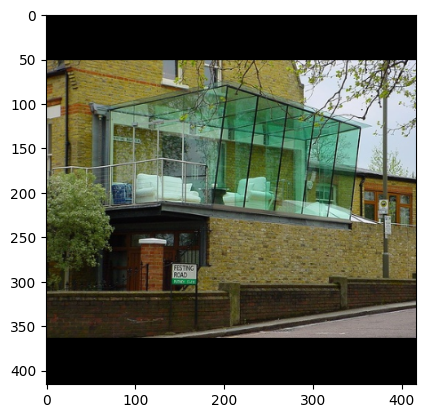

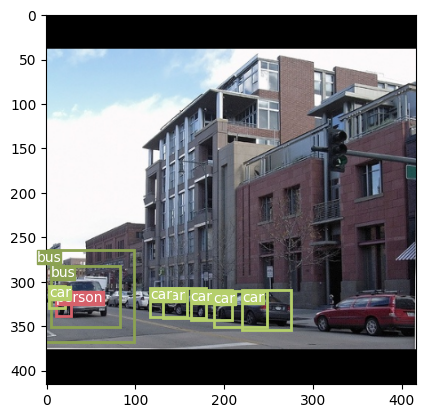

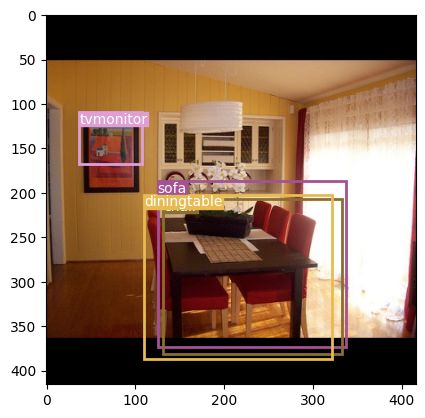

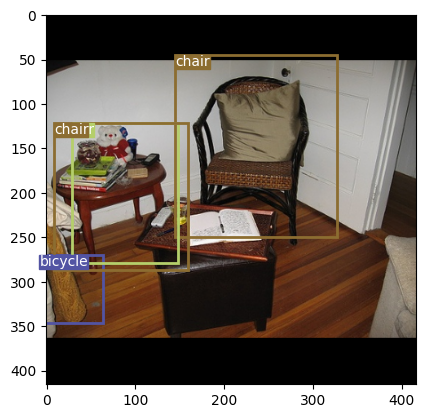

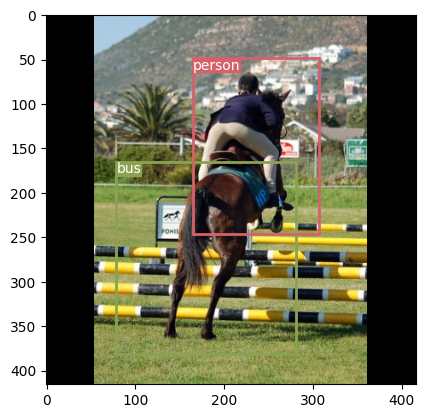

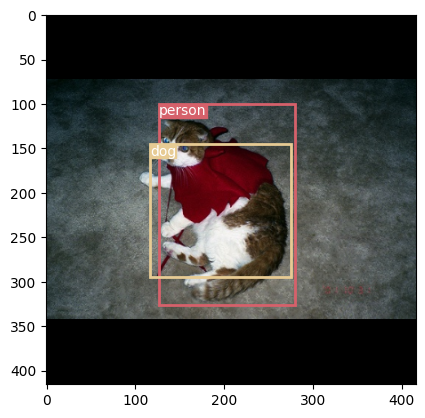

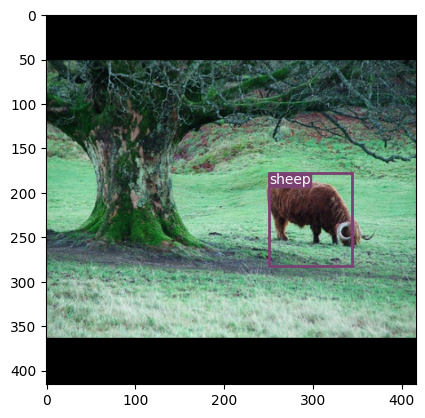

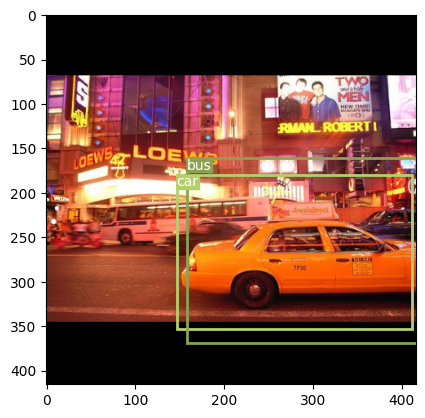

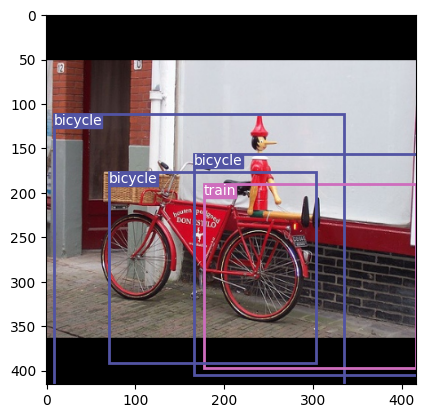

+++ TEST ACCURACIES



100%|██████████| 124/124 [01:04<00:00,  1.94it/s]


Class accuracy is: 70.834030%
No obj accuracy is: 96.883621%
Obj accuracy is: 68.185089%
Epoch: 19, Loss: 4.524842739105225
Epoch: 20, Loss: 4.402139186859131
Epoch: 21, Loss: 4.315126419067383
Epoch: 22, Loss: 4.205116271972656
+++ TRAIN ACCURACIES



100%|██████████| 414/414 [07:43<00:00,  1.12s/it]


Class accuracy is: 67.388000%
No obj accuracy is: 95.482338%
Obj accuracy is: 74.597534%
+++ TEST ACCURACIES



100%|██████████| 124/124 [01:02<00:00,  1.97it/s]


Class accuracy is: 77.700195%
No obj accuracy is: 96.674088%
Obj accuracy is: 71.964531%
Epoch: 23, Loss: 4.103285312652588


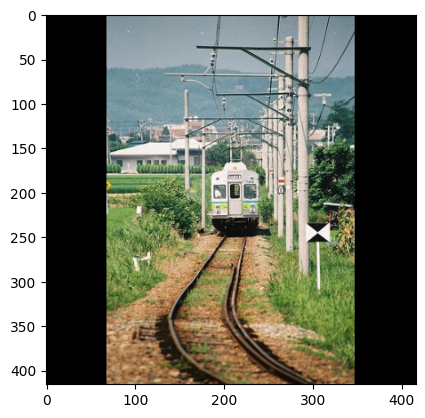

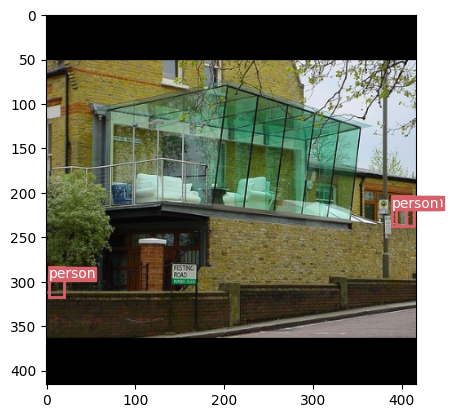

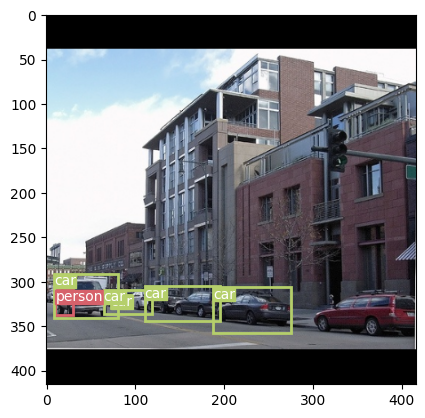

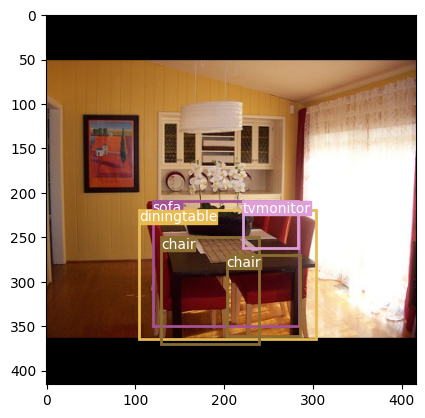

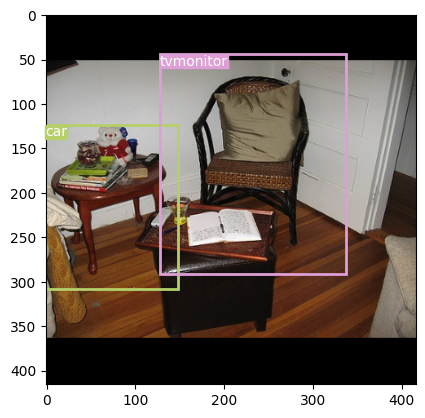

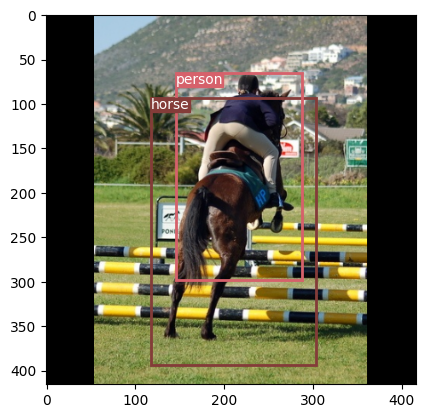

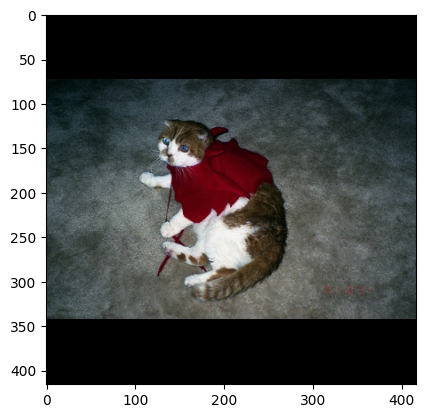

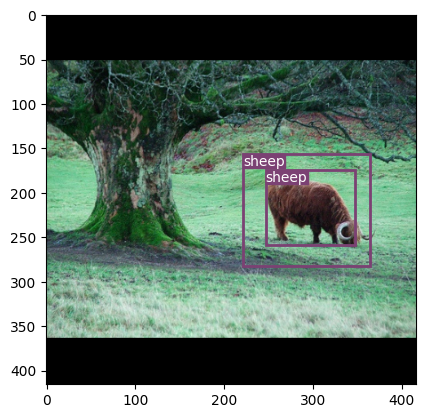

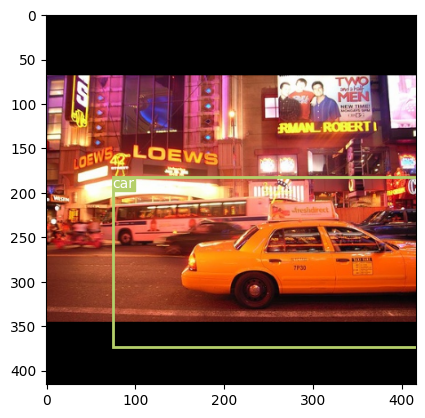

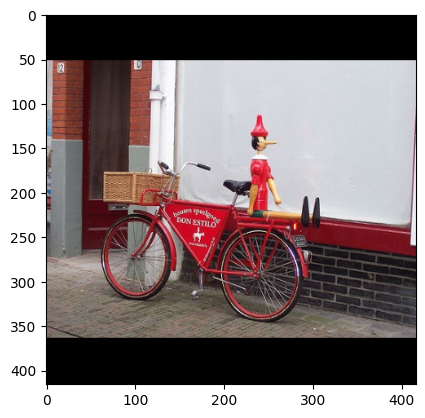

Epoch: 24, Loss: 4.014401435852051
Epoch: 25, Loss: 3.9082982540130615
Epoch: 26, Loss: 3.8202638626098633
+++ TEST ACCURACIES



100%|██████████| 124/124 [01:03<00:00,  1.96it/s]


Class accuracy is: 78.905518%
No obj accuracy is: 97.232094%
Obj accuracy is: 73.280685%
Epoch: 27, Loss: 3.7256128787994385
Epoch: 28, Loss: 3.6390113830566406


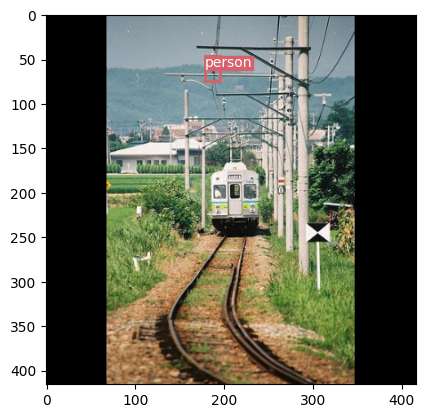

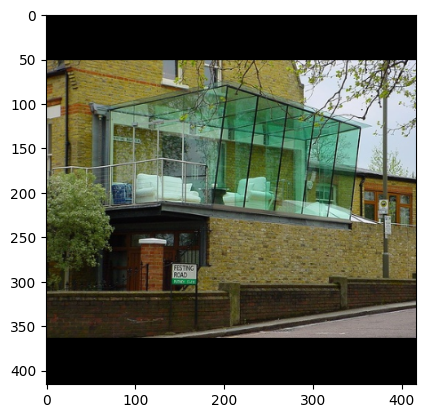

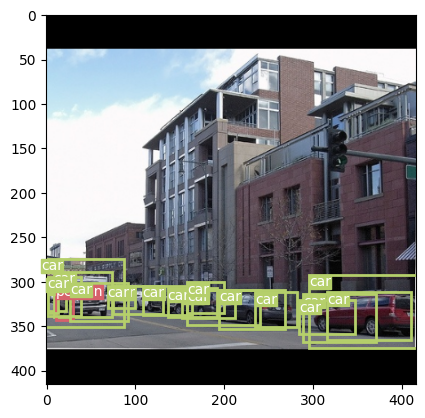

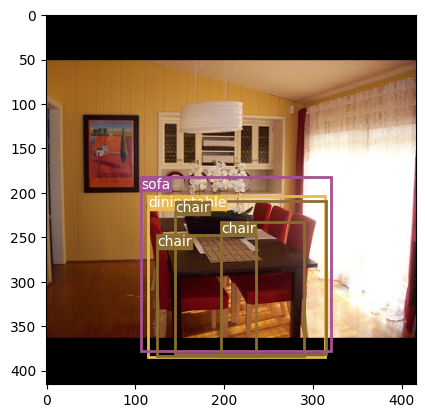

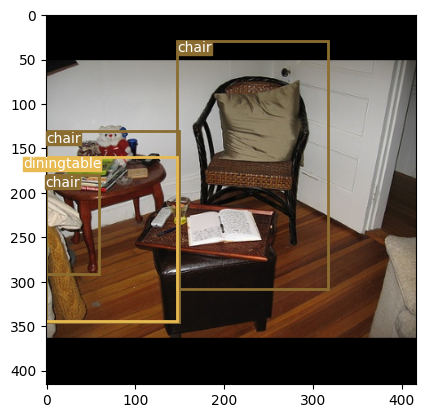

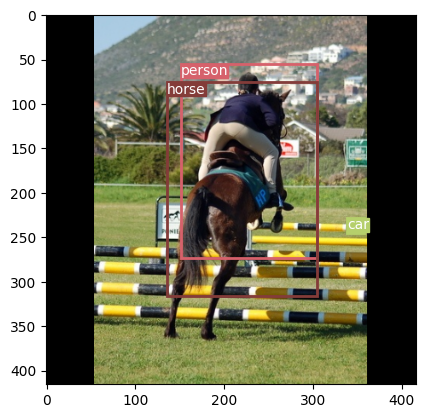

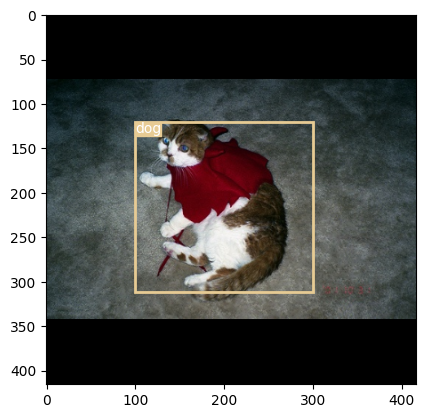

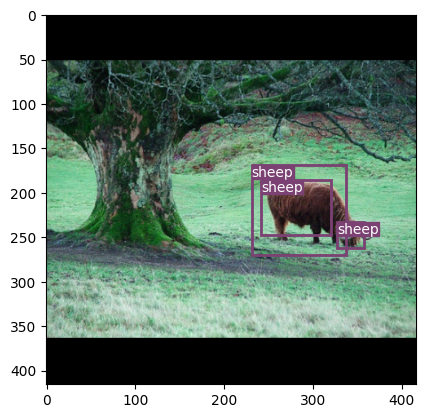

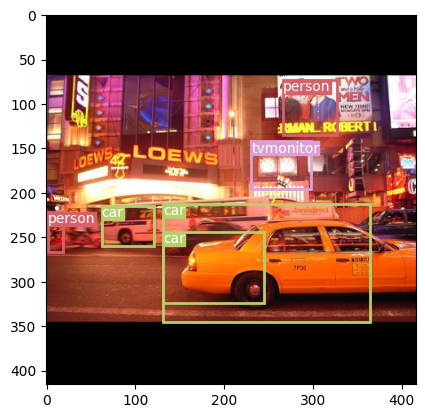

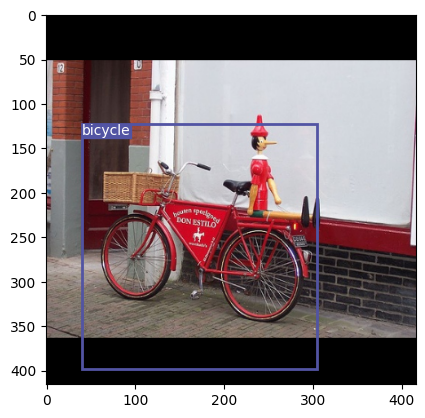

Epoch: 29, Loss: 3.52851939201355
Epoch: 30, Loss: 3.4508590698242188
+++ TRAIN ACCURACIES



100%|██████████| 414/414 [07:48<00:00,  1.13s/it]


Class accuracy is: 73.068008%
No obj accuracy is: 95.833298%
Obj accuracy is: 77.883049%
+++ TEST ACCURACIES



100%|██████████| 124/124 [01:03<00:00,  1.95it/s]


Class accuracy is: 81.773346%
No obj accuracy is: 96.864510%
Obj accuracy is: 75.272926%
Epoch: 31, Loss: 3.3701071739196777
Epoch: 32, Loss: 3.290649652481079
Epoch: 33, Loss: 3.2031702995300293


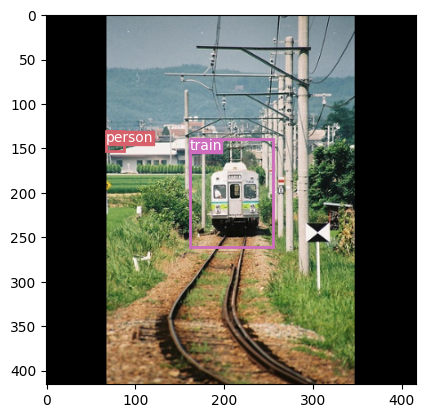

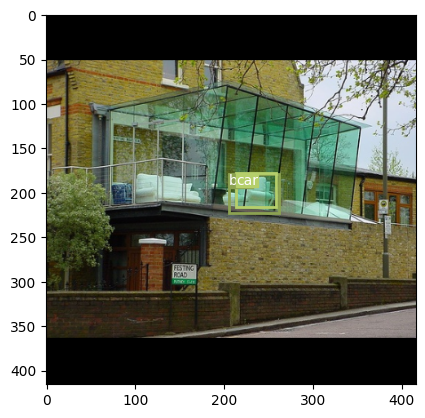

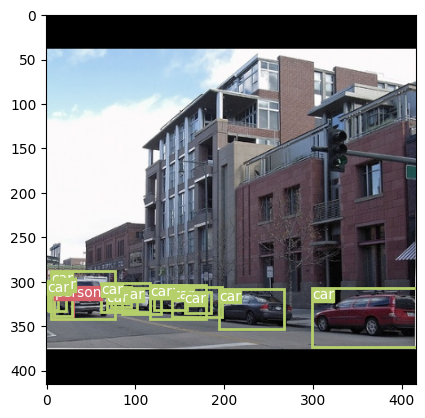

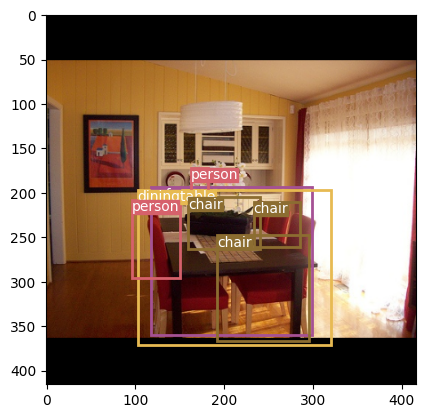

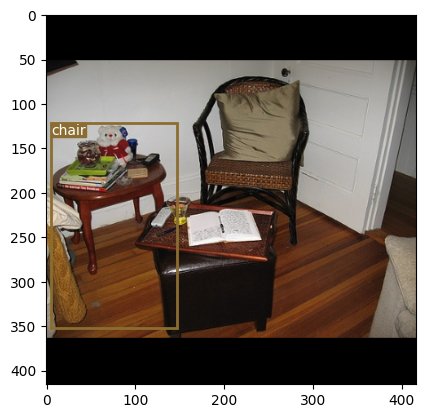

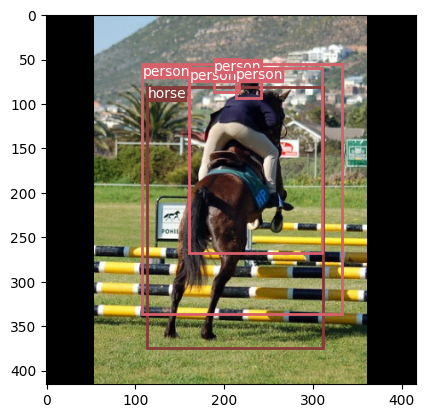

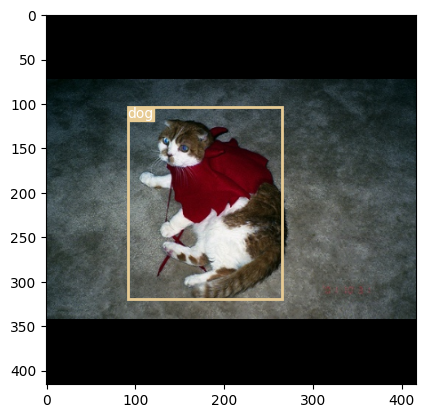

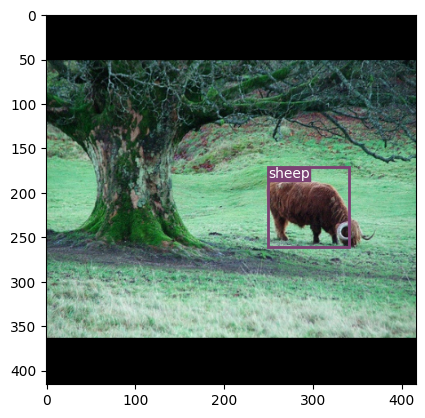

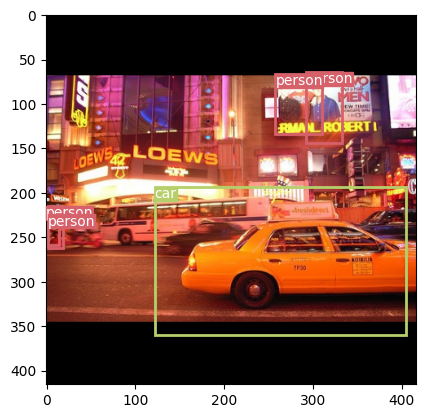

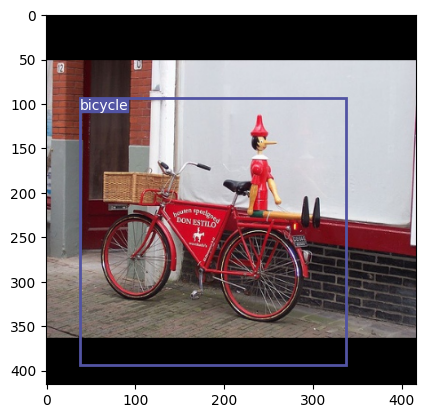

Epoch: 34, Loss: 3.1084444522857666
+++ TEST ACCURACIES



100%|██████████| 124/124 [01:01<00:00,  2.01it/s]


Class accuracy is: 85.336655%
No obj accuracy is: 97.280716%
Obj accuracy is: 77.104462%
Epoch: 35, Loss: 3.020203113555908
Epoch: 36, Loss: 2.930464744567871
Epoch: 37, Loss: 2.8547286987304688
Epoch: 38, Loss: 2.7558252811431885


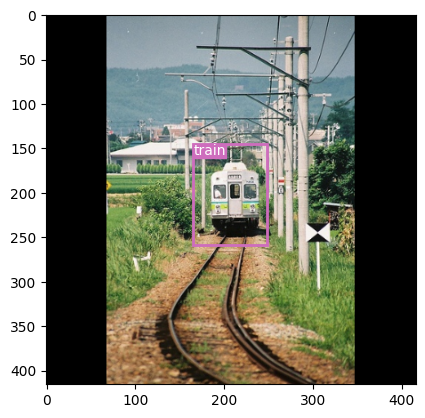

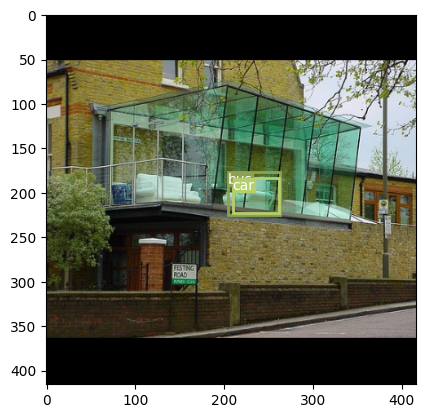

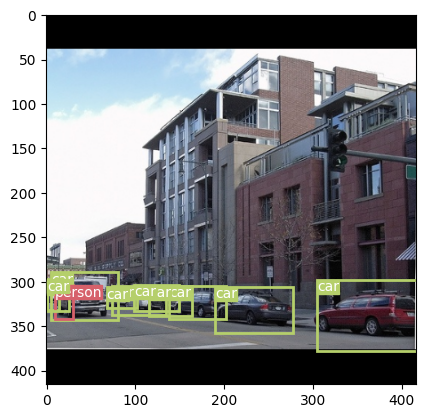

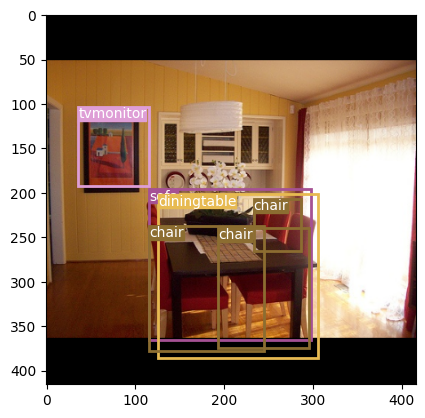

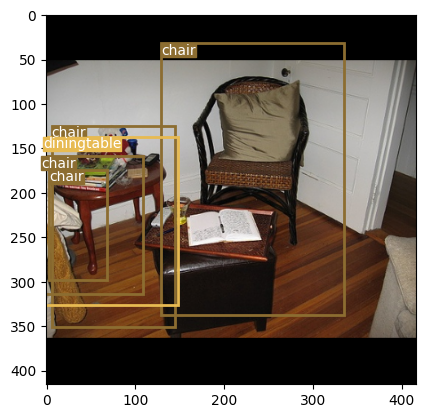

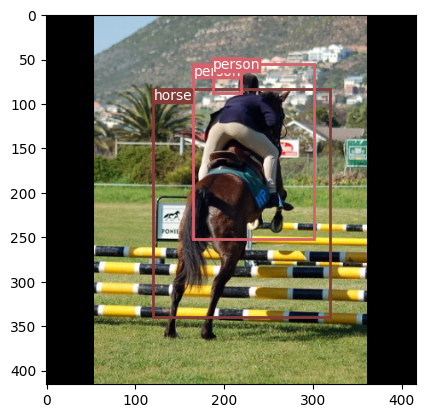

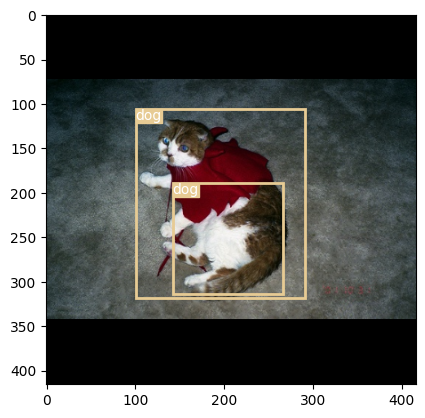

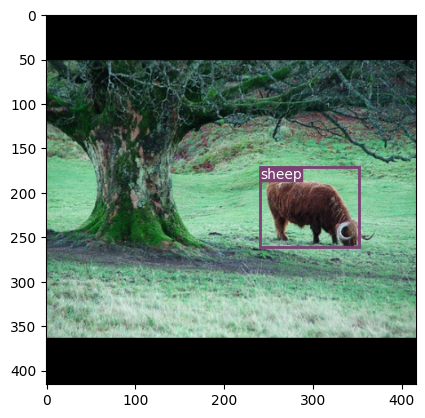

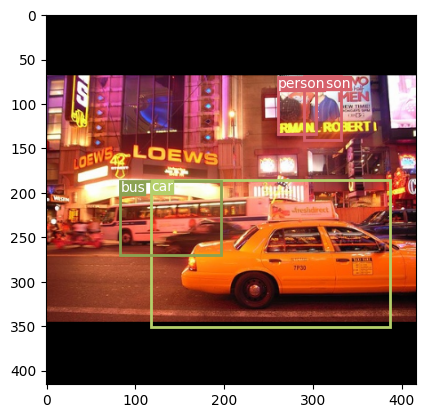

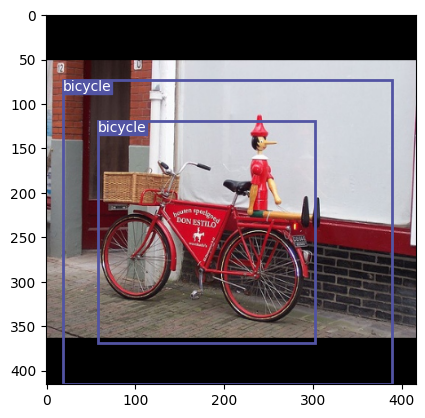

+++ TRAIN ACCURACIES



100%|██████████| 414/414 [07:46<00:00,  1.13s/it]


Class accuracy is: 81.400658%
No obj accuracy is: 96.601974%
Obj accuracy is: 79.738083%
+++ TEST ACCURACIES



100%|██████████| 124/124 [01:01<00:00,  2.03it/s]


Class accuracy is: 87.315048%
No obj accuracy is: 97.628883%
Obj accuracy is: 76.982544%



100%|██████████| 124/124 [28:27<00:00, 13.77s/it]


+++ MAP:  0.33122602105140686
Epoch: 39, Loss: 2.718630075454712


In [15]:
trainer.fit(model, data_module) 

In [16]:
!zip -r logs.zip /kaggle/working

  adding: kaggle/working/ (stored 0%)
  adding: kaggle/working/Utilities/ (stored 0%)
  adding: kaggle/working/Utilities/config.py (deflated 58%)
  adding: kaggle/working/Utilities/__pycache__/ (stored 0%)
  adding: kaggle/working/Utilities/__pycache__/dataset.cpython-310.pyc (deflated 46%)
  adding: kaggle/working/Utilities/__pycache__/transforms.cpython-310.pyc (deflated 35%)
  adding: kaggle/working/Utilities/__pycache__/callbacks.cpython-310.pyc (deflated 51%)
  adding: kaggle/working/Utilities/__pycache__/config.cpython-310.pyc (deflated 30%)
  adding: kaggle/working/Utilities/__pycache__/utils.cpython-310.pyc (deflated 52%)
  adding: kaggle/working/Utilities/__pycache__/loss.cpython-310.pyc (deflated 41%)
  adding: kaggle/working/Utilities/__pycache__/model.cpython-310.pyc (deflated 48%)
  adding: kaggle/working/Utilities/utils.py (deflated 72%)
  adding: kaggle/working/Utilities/model.py (deflated 73%)
  adding: kaggle/working/Utilities/loss.py (deflated 70%)
  adding: kaggle/wo

In [17]:
%ls

Store/  Utilities/  __notebook__.ipynb  logs.zip


In [18]:
from IPython.display import FileLink
FileLink(r'logs.zip')

/kaggle/working/logs.zip